### Data Visualization and Exploration
We will need to generate features of interest for our model. To do so, we will first need to generate some visualizations to better understand the range of values in our dataset. We will be interested in parameters like market capitalization, daily change in stock price and volume, the number of sectors in our dataset, and key metrics such as the price to earnings ratios, dividend yield, etc., which are reported or calculated on a quarterly basis.

In [1]:
import numpy as np
import pandas as pd

import math
import os

from datetime import datetime
from datetime import timedelta

# Import our custom API that retrieves financial market data from http://financialmodelingprep.com
import api
import api.tickers as tickers  # Information about stock, ETF, etc., tickers
import api.stocks  as stocks   # Information about stocks and stock indices

from api.stocks import Stock   # Information about a particular stock
from api.stocks import Index   # Information about a particular index

from api.stocks import TIMEDELTA_QUARTER
from api.stocks import TIMEDELTA_MONTH
from api.stocks import TIMEDELTA_YEAR

In [2]:
import matplotlib as mpl
import matplotlib.pyplot as plt

%matplotlib inline
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('svg')
font = {'weight' : 'normal',
        'size'   : 9}
mpl.rc('font', **font)
mpl.rcParams['axes.titlesize'] = 'medium'
mpl.rcParams['axes.labelsize'] = 'medium'

In [3]:
# Let's see how many S&P 500 stocks are available from our data source. 
sp500_tickers = tickers.get_sp500_tickers()
print("Number of S&P 500 stocks: ",len(sp500_tickers))

# Some S&P 500 tickers:
print("Sample S&P 500 tickers: ",sp500_tickers[:10])

Number of S&P 500 stocks:  499
Sample S&P 500 tickers:  ['MMM', 'ABT', 'ABBV', 'ABMD', 'ACN', 'ATVI', 'ADBE', 'AMD', 'AAP', 'AES']


In [4]:
stock_data = { ticker : Stock(ticker) for ticker in sp500_tickers }

In [5]:
from IPython.display import display

def cache_stocks(start,end):
    progress = display('',display_id=True)
    success_tickers = list()
    problem_tickers = list()
    
    stock_list = list(stock_data.keys())
    for i, ticker in enumerate(stock_list):
        try:
            progress.update(f'Caching {ticker} ({i+1}/{len(stock_list)})')
            stock_data[ticker].cache_data(start,end)
            success_tickers.append(ticker)         
        except:
            problem_tickers.append(ticker)
            continue
            
    progress.update('Caching complete!')
    print(f'Cached {len(success_tickers)} tickers: {", ".join(success_tickers)}.')
    if len(problem_tickers) > 0:
        print(f'The following tickers did not have complete data and were not cached: {", ".join(problem_tickers)}.')

In [6]:
# Cache data for the last 15 quarters (90 calendar days / quarter)
end_date   = datetime.today().date()
start_date = (end_date - TIMEDELTA_QUARTER*15)

In [7]:
# This is a potentially time-intensive operation
cache_stocks(start_date,end_date)

'Caching complete!'

Cached 493 tickers: MMM, ABT, ABBV, ABMD, ACN, ATVI, ADBE, AMD, AAP, AES, AFL, A, APD, AKAM, ALK, ALB, ARE, ALXN, ALGN, ALLE, AGN, ADS, LNT, ALL, GOOGL, MO, AMZN, AMCR, AEE, AAL, AEP, AXP, AIG, T, AMT, AWK, AMP, ABC, AME, AMGN, APH, ADI, ANSS, ANTM, AON, AOS, APA, AIV, AAPL, AMAT, APTV, ADM, ARNC, ANET, AJG, AIZ, ATO, ADSK, ADP, AZO, AVB, AVY, BKR, BLL, BAC, BK, BAX, BDX, BBY, BIIB, BLK, BA, BKNG, BWA, BXP, BSX, BMY, AVGO, BR, CHRW, COG, CDNS, CPB, COF, CPRI, CAH, KMX, CCL, CAT, CBOE, CBRE, CDW, CE, CNC, CNP, CTL, CERN, CF, SCHW, CHTR, CVX, CMG, CB, CHD, CI, CINF, CTAS, CSCO, C, CFG, CTXS, CLX, CME, CMS, KO, CTSH, CL, CMCSA, CMA, CAG, CXO, COP, ED, STZ, COO, CPRT, GLW, CTVA, COST, COTY, CCI, CSX, CMI, CVS, DHI, DHR, DRI, DVA, DE, DAL, XRAY, DVN, FANG, DLR, DFS, DISCA, DISH, DG, DLTR, D, DOV, DOW, DTE, DUK, DRE, DD, DXC, ETFC, EMN, ETN, EBAY, ECL, EIX, EW, EA, EMR, ETR, EOG, EFX, EQIX, EQR, ESS, EL, EVRG, ES, RE, EXC, EXPE, EXPD, EXR, XOM, FFIV, FB, FAST, FRT, FDX, FIS, FITB, FE, FISV, 

#### Market Capitalization, Industry and Sector

These are categorical features (i.e., singular features associated with a particular stock with no time-series component). Market capitalization does change over time, however we are interested in "how big" a company is over a relatively narrow period of time. The S&P500 includes only large-cap companies by definition, however we will want to explore how performance correlates with size.

In [8]:
# Look at the market capitalization of companies in the S&P 500
problem_tickers = list()
profile_df = pd.DataFrame()

for stock in sp500_tickers:
    try:
        profile_df = pd.concat([profile_df,stock_data[stock].get_company_profile()],axis=0)
    except:
        problem_tickers.append(stock)
        continue
     
if len(problem_tickers) > 0:
    print(f'The following tickers did not have profile information: {", ".join(problem_tickers)}')

profile_df.dropna(inplace=True)

In [9]:
profile_df.head()

,beta,ceo,changes,changesPercentage,companyName,description,exchange,image,industry,lastDiv,mktCap,price,range,sector,volAvg,website
MMM,1.096121,Inge G. Thulin,2.24,(+1.48%),3M Company,3M Co is a diversified technology company. It ...,New York Stock Exchange,https://financialmodelingprep.com/images-New-j...,Industrial Products,5.76,8.8440938E10,153.65,144.44-219.75,Industrials,3675475,http://www.3m.com
ABT,1.112141,Miles D. White,1.22,(+1.52%),Abbott Laboratories,Abbott Laboratories is a health care company t...,New York Stock Exchange,https://financialmodelingprep.com/images-New-j...,Drug Manufacturers,1.28,1.44142762E11,81.74,72.36-92.45,Healthcare,5531063,http://www.abbott.com
ABBV,0.952782,Richard A. Gonzalez,-1.79,(-1.98%),AbbVie Inc.,AbbVie Inc is a biopharmaceutical company that...,New York Stock Exchange,https://financialmodelingprep.com/images-New-j...,Drug Manufacturers,4.28,1.31378995E11,88.82,62.66-97.86,Healthcare,9299111,http://www.abbvie.com
ABMD,0.32462,Michael R. Minogue,2.57,(+1.66%),ABIOMED Inc.,Abiomed Inc is a medical device company. It pr...,Nasdaq Global Select,https://financialmodelingprep.com/images-New-j...,Medical Devices,0,7.0784492E9,157.08,147.28-348.28,Healthcare,889734,http://www.abiomed.com
ACN,1.036256,Pierre Nanterme,-3.81,(-2.09%),Accenture plc Class A (Ireland),Accenture PLC is a professional service compan...,New York Stock Exchange,https://financialmodelingprep.com/images-New-j...,Application Software,2.92,1.13674994E11,178.75,161.99-216.39,Technology,2290014,http://www.accenture.com


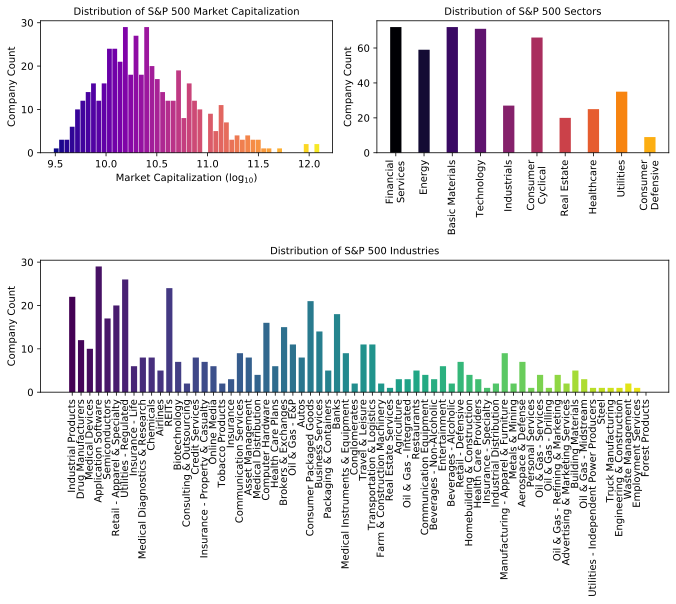

In [10]:
from textwrap import wrap

market_cap = profile_df['mktCap'].to_numpy().astype(dtype='float32')
market_cap = np.log(market_cap) / np.log(10)

industries = profile_df['industry'].to_numpy()
industries_set = set(industries)

sectors = profile_df['sector'].to_numpy()
sectors_set = set(sectors)
sectors_labels = list()
for text in sectors_set:
    sectors_labels.append("\n".join(wrap(text,width=15)))

fig = plt.figure(figsize=(9.5,8.5))

ax1 = plt.subplot2grid((2, 2), (0, 0))
ax2 = plt.subplot2grid((2, 2), (0, 1))
ax3 = plt.subplot2grid((2, 2), (1, 0), colspan=2)    

ax1.set_title('Distribution of S&P 500 Market Capitalization')
ax1.set_ylabel('Company Count')
ax1.set_xlabel('Market Capitalization (log$_{10}$)')
n, bins, patches = ax1.hist(market_cap,bins=50,rwidth=0.9);
color = [i/len(bins) for i in range(len(bins))]
for c, p in zip(color, patches):
    plt.setp(p, 'facecolor', plt.cm.plasma(c))

ax2.set_title('Distribution of S&P 500 Sectors')
ax2.set_ylabel('Company Count')
ax2.tick_params(axis='x', rotation=90)
sectors_len = len(sectors_set)
_, _, patches = ax2.hist(sectors,bins=np.arange(sectors_len)-0.5,rwidth=0.4)
color = [i/sectors_len for i in range(sectors_len)]
for c, p in zip(color, patches):
    plt.setp(p, 'facecolor', plt.cm.inferno(c))
ax2.set_xticklabels(sectors_labels)

ax3.set_title('Distribution of S&P 500 Industries')
ax3.set_ylabel('Company Count')
ax3.tick_params(axis='x', rotation=90)
industries_len = len(industries_set)
_, _, patches = ax3.hist(industries,bins=np.arange(industries_len)-0.5,rwidth=0.7);
color = [i/industries_len for i in range(industries_len)]
for c, p in zip(color, patches):
    plt.setp(p, 'facecolor', plt.cm.viridis(c))
ax3.set_xticks(list(range(industries_len)),list(industries_set))

fig.tight_layout();

#### Daily Closing Price and Volume

We are interested in the relative change in daily close price among the stocks. In particular, we want to see what kind of ranges (i.e., magnitude of fractional changes) we might expect during the period of interest. 

In [11]:
stock_data['AAPL'].get_historical_prices(start_date,end_date)

,date,open,high,low,close,adjClose,volume,unadjustedVolume,change,changePercent,vwap,label,changeOverTime
0,2016-06-29,93.97,94.55,93.63,94.40,89.50,36531000.0,36531000.0,-0.43,-0.458,94.19333,"June 29, 16",-0.00458
1,2016-06-30,94.44,95.77,94.30,95.60,90.64,35836400.0,35836400.0,-1.16,-1.228,95.22333,"June 30, 16",-0.01228
2,2016-07-01,95.49,96.47,95.33,95.89,90.91,26026500.0,26026500.0,-0.40,-0.419,95.89667,"July 01, 16",-0.00419
3,2016-07-05,95.39,95.40,94.46,94.99,90.06,27705200.0,27705200.0,0.40,0.419,94.95000,"July 05, 16",0.00419
4,2016-07-06,94.60,95.66,94.37,95.53,90.57,30949100.0,30949100.0,-0.93,-0.983,95.18667,"July 06, 16",-0.00983
...,...,...,...,...,...,...,...,...,...,...,...,...,...
923,2020-03-02,282.28,301.44,277.72,298.81,298.81,85349300.0,85349300.0,-16.53,-5.856,292.65667,"March 02, 20",-0.05856
924,2020-03-03,303.67,304.00,285.80,289.32,289.32,79868900.0,79868900.0,14.35,4.726,293.04000,"March 03, 20",0.04726
925,2020-03-04,296.44,303.40,293.13,302.74,302.74,54794600.0,54794600.0,-6.30,-2.125,299.75667,"March 04, 20",-0.02125
926,2020-03-05,295.52,299.55,291.41,292.92,292.92,46893200.0,46893200.0,2.60,0.880,294.62667,"March 05, 20",0.00880


In [12]:
# Normalize stock prices to the initial value for the period and normalize 
# volume with respect to the average volume over the period
fig = plt.figure(figsize=(12,7.5))

ax_list = [ plt.subplot2grid( (2,2), (int(i/2), i%2)) for i in range(4)]
plt.subplots_adjust(hspace=0.3)

for i, ax in enumerate(ax_list):
    if i % 2 == 0:
        ax.set_prop_cycle('color',[plt.cm.viridis(i) for i in np.linspace(0, 1, 50)])
        ax.set_title(f'Group {int(i/2)} (Close Price)')
        ax.set_ylabel('Relative Close Price')
        ax.set_ylim([0.1,10])
    else:
        ax.set_prop_cycle('color',[plt.cm.plasma(i) for i in np.linspace(0, 1, 50)])
        ax.set_title(f'Group {int(i/2)} (Volume)')
        ax.set_ylabel('Relative Volume')
        ax.set_ylim([0.01,100])
    ax.set_yscale('log')
    ax.set_xlabel('Trading Day')
    ax.set_xlim([0,850])

for i, stock in enumerate(sp500_tickers):   
    try:
        data_df = stock_data[stock].get_historical_prices(start_date,end_date)
        close_price = data_df['close']
        close_price = close_price / close_price.iat[0] 
        volume = data_df['volume']
        volume = volume / volume.mean()
    except:
        continue
    
    # Indices of axes to use for price and volume
    idx_price = int(i%(len(ax_list)/2)*2)
    idx_volume = idx_price + 1 
    
    ax_list[idx_price].plot(close_price)
    ax_list[idx_volume].plot(volume)

#### Price-to-Earnings Ratios, Price-to-Sales Ratios, Price-to-Book Ratios, Dividend Yield, etc.

These are quarterly features (i.e., [derived] figures that are published once every three months). We will be interested in including one or more of these parameters in our model. It is important to note the spread in magnitude of these values as we will need to normalize them for our network.

In [13]:
stock_data['AAPL'].get_key_metrics(5,0)

,date,Revenue per Share,Net Income per Share,Operating Cash Flow per Share,Free Cash Flow per Share,Cash per Share,Book Value per Share,Tangible Book Value per Share,Shareholders Equity per Share,Interest Debt per Share,...,Graham Number,Graham Net-Net,Working Capital,Tangible Asset Value,Net Current Asset Value,Invested Capital,Average Receivables,Average Payables,Average Inventory,Capex per Share
0,2018-09-29,13.0998,2.9417,4.0659,4.984,5.3968,22.315,76.168,22.3149,23.8427,...,77.6535,-0.1159,15410000000.0,365725000000.0,-127239000000.0,338366000000.0,42334000000.0,50065000000.0,4405500000.0,-0.6333
1,2018-12-29,17.8026,4.2157,5.6358,2.207,9.4537,24.894,78.913,24.8937,24.226,...,82.9012,-0.1536,32545000000.0,373719000000.0,-114999000000.0,335395000000.0,43940000000.0,53639000000.0,4704500000.0,-0.7084
2,2019-03-30,12.4121,2.4734,2.3866,2.298,8.1274,22.648,73.169,22.6484,24.0968,...,78.1656,-0.1251,29574000000.0,341998000000.0,-112792000000.0,322868000000.0,24343000000.0,32377000000.0,6273000000.0,-0.5056
3,2019-06-29,11.7728,2.1975,2.5458,3.433,11.0554,21.103,70.502,21.1034,23.7206,...,74.9473,-0.0979,45269000000.0,322239000000.0,-90810000000.0,290423000000.0,26420500000.0,33802000000.0,4645500000.0,-0.4376
4,2019-09-28,14.2602,3.0476,4.4335,4.927,10.8764,20.15,75.38,20.1496,24.0596,...,73.6675,-0.0842,57101000000.0,338516000000.0,-85209000000.0,292001000000.0,47399500000.0,51062000000.0,4031000000.0,-0.6184


In [14]:
# Retain only the following valuation ratios + dividend yield
key_metrics_list = {'PE ratio' : 'Price to Earnings Ratio',
                    'Price to Sales Ratio' : 'Price to Sales Ratio',
                    'PB ratio' : 'Price to Book Ratio',
                    'PFCF ratio' : 'Price to Free Cash Flow Ratio',
                    'EV to Sales' : 'Enterprise Value to Sale Ratio',
                    'Dividend Yield' : 'Dividend Yield'}

key_metrics_dict = { key_metric : pd.DataFrame() for key_metric in key_metrics_list }

# Look at data for the last few quarters
QUARTERS_TO_RETAIN = 10

# Keep track of how many tickers didn't have sufficient data
problem_tickers = list()

# Iterate over stocks and aggregate dataframes containing our metrics of interest
for stock in sp500_tickers:
    try:
        key_metrics_df = stock_data[stock].get_key_metrics(QUARTERS_TO_RETAIN,offset=0)

        for metric in key_metrics_list.keys():
            key_metrics_df[metric].name=stock
            key_metrics_dict[metric] = pd.concat([key_metrics_dict[metric],key_metrics_df[metric].astype(float)],axis=1)
    except:
        problem_tickers.append(stock)
        continue
     
if len(problem_tickers) > 0:
    print(f'The following tickers did not have sufficient quarterly information: {", ".join(problem_tickers)}')

The following tickers did not have sufficient quarterly information: AMCR, BRK.B, BF.B, CTVA, DOW, DRE, FRC, FOXA, J, LIN, TFC, UDR, VIAC


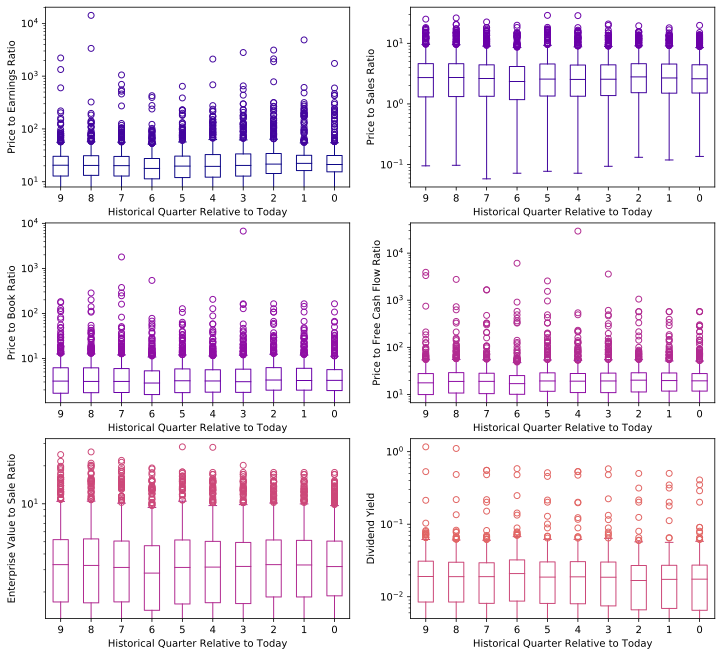

In [15]:
# Plot min, max and average values for each of the metrics
metric_count = len(key_metrics_list)
plots_per_row = 2
plots_per_col = int(metric_count / plots_per_row)

x_values = range(QUARTERS_TO_RETAIN)

fig = plt.figure(figsize=(12,3.75*plots_per_col))

for i,metric in enumerate(key_metrics_list.keys()): 
    ax = plt.subplot2grid( (plots_per_col,plots_per_row), (int(i/plots_per_row),i%plots_per_row))
    data = key_metrics_dict[metric].transpose()
    box = data.boxplot(ax=ax,column=list(data.columns),grid=False,return_type='dict')

    for item in ['boxes', 'whiskers', 'fliers', 'medians', 'caps']:
        plt.setp(box[item], color=plt.cm.plasma(i*0.1), markeredgecolor=plt.cm.plasma(i*0.1+0.1))

    ax.invert_xaxis()
    ax.set_title('')
    ax.set_ylabel(key_metrics_list[metric])
    ax.set_yscale('log')
    ax.set_xlabel('Historical Quarter Relative to Today')

In [16]:
# Retain only the following income figures
income_figures_list = {'EPS Diluted' : 'EPS (Diluted)',
                       'EPS' : 'EPS',
                       'Revenue Growth' : 'Revenue Growth',
                       'Profit Margin'  : 'Profit Margin'
                      }
income_figures_dict = { income_figure : pd.DataFrame() for income_figure in income_figures_list }

# Look at data for the last few quarters
QUARTERS_TO_RETAIN = 10

# Keep track of how many tickers didn't have sufficient data
problem_tickers = list()

# Iterate over stocks and aggregate dataframes containing income figures of interest
for stock in sp500_tickers:
    try:
        income_figures_df = stock_data[stock].get_income_statement(QUARTERS_TO_RETAIN,offset=0)

        for income_figure in income_figures_list:
            income_figures_df[income_figure].name=stock
            income_figures_dict[income_figure] = pd.concat(
                [income_figures_dict[income_figure],
                 income_figures_df[income_figure].astype(float)],axis=1)
    except:
        problem_tickers.append(stock)
        continue
     
if len(problem_tickers) > 0:
    print(f'The following tickers did not have sufficient income information: {", ".join(problem_tickers)}')

The following tickers did not have sufficient income information: AMCR, BKR, CTVA, DOW, FRC, FOXA, M, VIAC


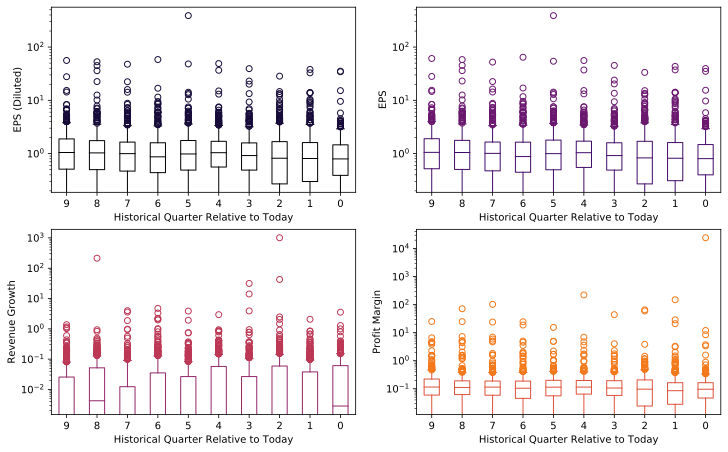

In [17]:
# Plot min, max and average values for each of the metrics
income_figure_count = len(income_figures_list)
plots_per_row = 2
plots_per_col = int(income_figure_count / plots_per_row)

x_values = range(QUARTERS_TO_RETAIN)

fig = plt.figure(figsize=(12,3.75*plots_per_col))

for i,income_figure in enumerate(income_figures_dict.keys()):  
    ax = plt.subplot2grid( (plots_per_col,plots_per_row), (int(i/plots_per_row),i%plots_per_row))
    data = income_figures_dict[income_figure].transpose()
    box = data.boxplot(ax=ax,column=list(data.columns),grid=False,return_type='dict')
    
    for item in ['boxes', 'whiskers', 'fliers', 'medians', 'caps']:
        plt.setp(box[item], color=plt.cm.inferno(i*0.2), markeredgecolor=plt.cm.inferno(i*0.2+0.1))
        
    ax.invert_xaxis()
    ax.set_title('')
    ax.set_ylabel(income_figures_list[income_figure])
    ax.set_yscale('log')
    ax.set_xlabel('Historical Quarter Relative to Today')